In [278]:
import cv2
import numpy as np
import glob
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
%matplotlib inline

In [279]:
plt.rcParams["figure.figsize"] = (18,8)

In [280]:
folder_path = "./data/Video_with_chessboard/save_frames_10.222.255.22/" + "*.jpg"

In [281]:
filename_matrix = "./data/Video_with_chessboard/save_frames_10.222.255.22/cameraMatrix.txt"
filename_distortion = "./data/Video_with_chessboard/save_frames_10.222.255.22/cameraDistortion.txt"

In [282]:
CHECKERBOARD = (9, 7)

In [283]:
subpix_criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-4)

calibration_flags = cv2.fisheye.CALIB_RECOMPUTE_EXTRINSIC + cv2.fisheye.CALIB_FIX_SKEW #+cv2.fisheye.CALIB_CHECK_COND

In [284]:
objp = np.zeros((1, CHECKERBOARD[0] * CHECKERBOARD[1], 3), np.float32)

In [285]:
objp[0, :, :2] = np.mgrid[0: CHECKERBOARD[0], 0:CHECKERBOARD[1]].T.reshape(-1, 2)
print(objp.shape)

(1, 63, 3)


In [286]:
_img_shape = None
#3d point in real world
objpoints = []
# 3d points in image plane
imgpoints = []

In [287]:
images = glob.glob(folder_path)
print("[INFO] Number of images in the folder : ", len(images))

[INFO] Number of images in the folder :  17


In [288]:
num_ret_true = 0
name_ = 0
for img in tqdm(images):
    name_ += 1
    img = cv2.imread(img)
    
    if _img_shape == None:
        _img_shape = img.shape[:2]
    else:
        # all images must share the same size
        assert _img_shape == img.shape[:2]  
    
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#     plt.imshow(gray_img)
#     plt.show()
    
    # find the corners on the checkerboard
#     ret, corners = cv2.findChessboardCorners(gray_img,
#                                              CHECKERBOARD, 
#                                              None)
    
    ret, corners = cv2.findChessboardCorners(gray_img,
                                             CHECKERBOARD,                                              
    cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_FAST_CHECK + cv2.CALIB_CB_NORMALIZE_IMAGE)
    
    if ret == True:
        print("Found it!")
        num_ret_true += 1
        objpoints.append(objp)
        corners = cv2.cornerSubPix(gray_img, 
                                   corners, 
                                   (11, 11), 
                                   (-1, -1), 
                                   subpix_criteria)
        imgpoints.append(corners)
        
        #cv2.drawChessboardCorners(img, (9, 7), corners,ret)
        #cv2.drawChessboardCorners(img, (nCols,nRows), corners, ret)
        
        #img_convert = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        #plt.imshow(img_convert)
        #plt.show()        
    

  0%|                                                                                           | 0/17 [00:00<?, ?it/s]

Found it!


 12%|█████████▊                                                                         | 2/17 [00:03<00:23,  1.57s/it]

Found it!


 24%|███████████████████▌                                                               | 4/17 [00:04<00:13,  1.01s/it]

Found it!


 29%|████████████████████████▍                                                          | 5/17 [00:04<00:10,  1.10it/s]

Found it!


 53%|███████████████████████████████████████████▉                                       | 9/17 [00:16<00:14,  1.84s/it]

Found it!


 59%|████████████████████████████████████████████████▏                                 | 10/17 [00:17<00:11,  1.70s/it]

Found it!


 65%|█████████████████████████████████████████████████████                             | 11/17 [00:17<00:09,  1.59s/it]

Found it!


 71%|█████████████████████████████████████████████████████████▉                        | 12/17 [00:17<00:07,  1.49s/it]

Found it!


 76%|██████████████████████████████████████████████████████████████▋                   | 13/17 [00:18<00:05,  1.41s/it]

Found it!


 82%|███████████████████████████████████████████████████████████████████▌              | 14/17 [00:18<00:04,  1.34s/it]

Found it!


 88%|████████████████████████████████████████████████████████████████████████▎         | 15/17 [00:19<00:02,  1.27s/it]

Found it!


 94%|█████████████████████████████████████████████████████████████████████████████▏    | 16/17 [00:19<00:01,  1.22s/it]

Found it!


100%|██████████████████████████████████████████████████████████████████████████████████| 17/17 [00:19<00:00,  1.17s/it]


In [289]:
print("Number of chessboards had found ({0})/ Number of total images ({1})".format(num_ret_true, len(images)))

Number of chessboards had found (12)/ Number of total images (17)


In [290]:
N_OK = len(objpoints)
K = np.zeros((3, 3))
D = np.zeros((4, 1))

rvecs = [np.zeros((1, 1, 3), dtype=np.float32) for i in range(N_OK)]
tvecs = [np.zeros((1, 1, 3), dtype=np.float32) for i in range(N_OK)]

In [291]:
# rms, camera_matrix, dist_coefs, rvecs, tvecs = \
#     cv2.fisheye.calibrate(
#         objpoints,
#         imgpoints,
#         gray_img.shape[::-1],
#         K,
#         D,
#         rvecs,
#         tvecs,
#         calibration_flags,
#         (cv2.TERM_CRITERIA_EPS+cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-3),
#     )

retval, _, _, rvecs, tvecs = cv2.fisheye.calibrate(
    objpoints,
    imgpoints,
    gray_img.shape[::-1],
    K,
    D,
    rvecs,
    tvecs,
    calibration_flags,
    (cv2.TERM_CRITERIA_EPS+cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-3)
)

In [292]:
DIM = _img_shape[::-1]
K = np.array(K.tolist())
D = np.array(D.tolist())

In [293]:
D, DIM, K

(array([[0.],
        [0.],
        [0.],
        [0.]]),
 (2048, 1536),
 array([[6.51898647e+02, 0.00000000e+00, 1.02350000e+03],
        [0.00000000e+00, 6.51898647e+02, 7.67500000e+02],
        [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]]))

In [294]:
def load_txt_files(filename_matrix, filename_distortion):           

    scaled_K = np.loadtxt(filename_matrix, delimiter=",")
    
    D        = np.loadtxt(filename_distortion, delimiter=",")
        
    return scaled_K, D        

In [295]:
# undistort
def undistort(img_path, scaled_K = None, D = None, balance = 0.0):
    
    print(img_path)
    img = cv2.imread(img_path)
    # dimension of input to undistorrt
    dimesion = img.shape[:2][::-1]
    # "Image to undistort needs to have same aspect ratio as the ones used in calibration"
    #assert dimesion[0]/dimesion[1] == DIM[0]/DIM[1]             
    
    # Check if text file already save or not    
    if os.path.exists(filename_matrix):
        #print("Not None")
        # If files already exists
        #scaled_K, D = load_txt_files(filename_matrix, filename_distortion)
        
        new_K = cv2.fisheye.estimateNewCameraMatrixForUndistortRectify(scaled_K, 
                                                                   D, 
                                                                   dimesion, 
                                                                   np.eye(3), 
                                                                   balance=balance)
    
        map1, map2 = cv2.fisheye.initUndistortRectifyMap(scaled_K, 
                                                         D, 
                                                         np.eye(3), 
                                                         new_K, 
                                                         dimesion, 
                                                         cv2.CV_16SC2)
            
                        
    
    else:    
        # scale by the image dimension
        scaled_K = K * dimesion[0] / DIM[0]
        # value in the most right lower of matrix calibration
        scaled_K[2][2] = 1.0
        
        ###

        new_K = cv2.fisheye.estimateNewCameraMatrixForUndistortRectify(scaled_K, 
                                                                       D, 
                                                                       dimesion, 
                                                                       np.eye(3), 
                                                                       balance=balance)

        map1, map2 = cv2.fisheye.initUndistortRectifyMap(scaled_K, 
                                                         D, 
                                                         np.eye(3), 
                                                         new_K, 
                                                         dimesion, 
                                                         cv2.CV_16SC2)
            
        ### Save the result        
        print("Couldn't find the file with parameter, save new files")
        np.savetxt(filename_matrix, scaled_K, delimiter=',')        
        np.savetxt(filename_distortion, D, delimiter=',')
                
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undistorted = cv2.remap(img, 
                            map1, 
                            map2, 
                            interpolation = cv2.INTER_LINEAR, 
                            borderMode = cv2.BORDER_CONSTANT)   
        
    show_save_subplot(img, undistorted, balance, img_path)


In [296]:
def show_save_subplot(original_img, undistorted_img, balance, img_path):
    
    name = "undistorted_" + str(balance) + "_" + os.path.basename(img_path)
    
    ax = plt.subplot(121)
    ax.set_title("Original")
    plt.imshow(original_img)

    ax = plt.subplot(122)
    ax.set_title("Undistorted")
    plt.imshow(undistorted_img)
    
    #plt.savefig(name)
    plt.show()

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_0.jpg


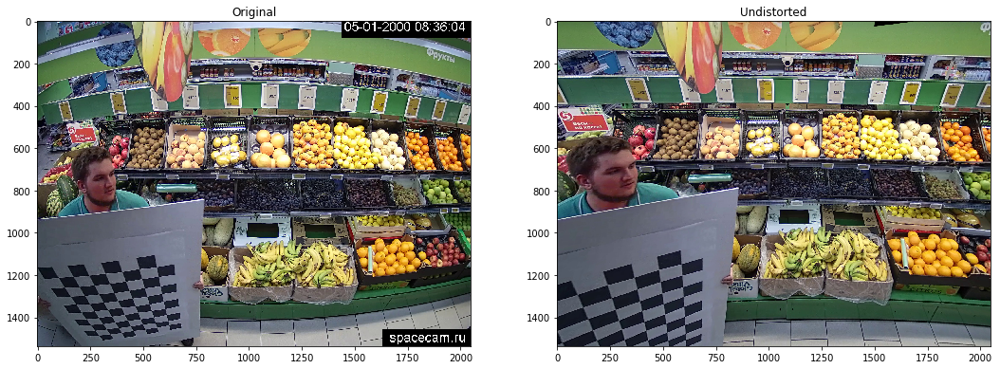

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_1.jpg


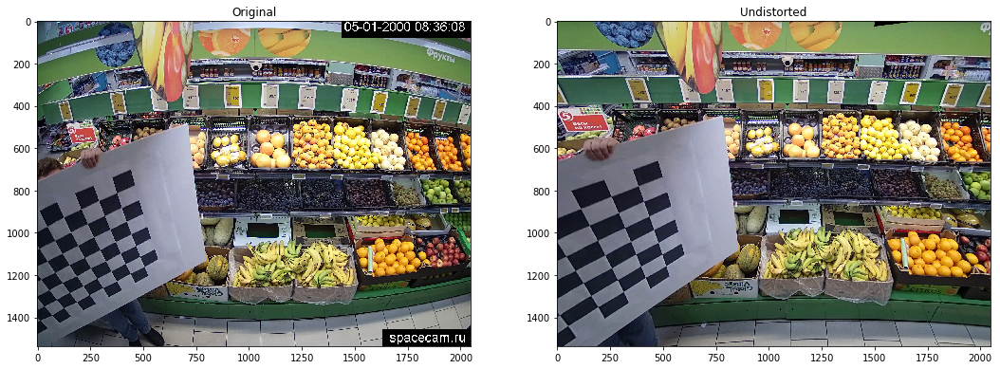

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_10.jpg


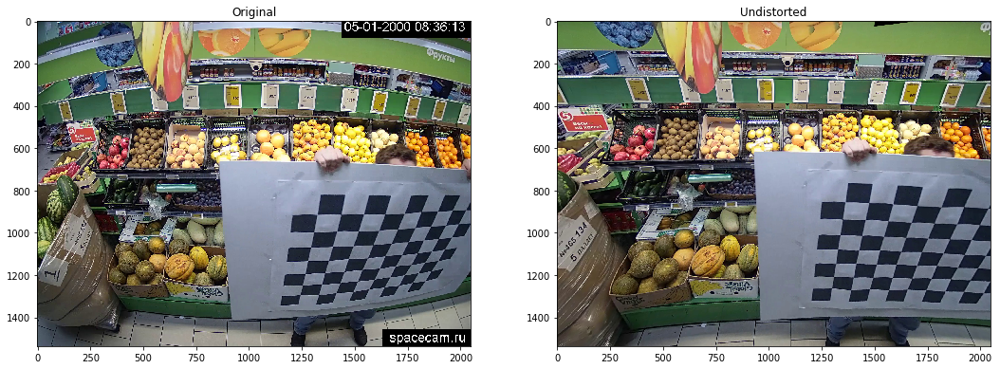

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_11.jpg


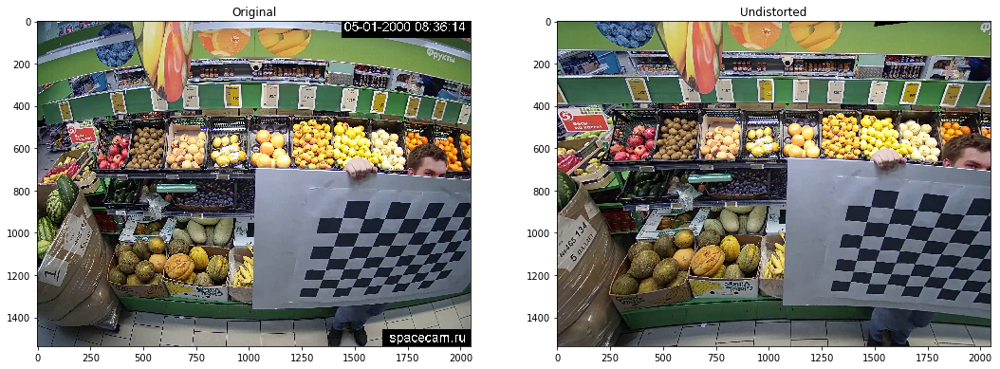

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_12.jpg


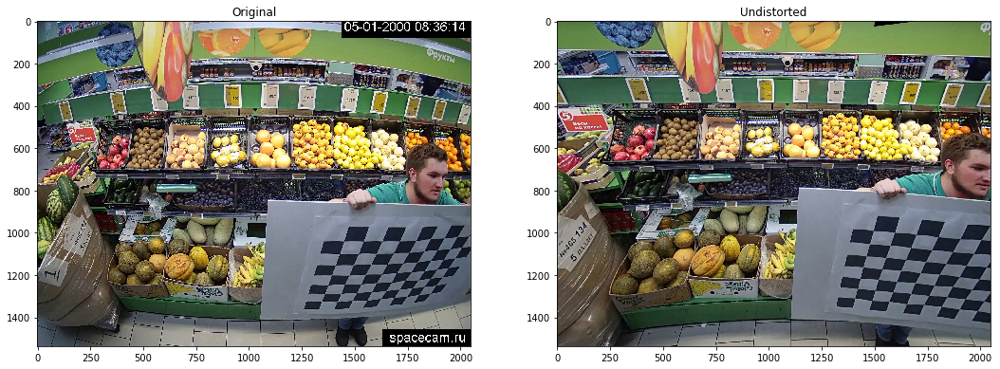

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_13.jpg


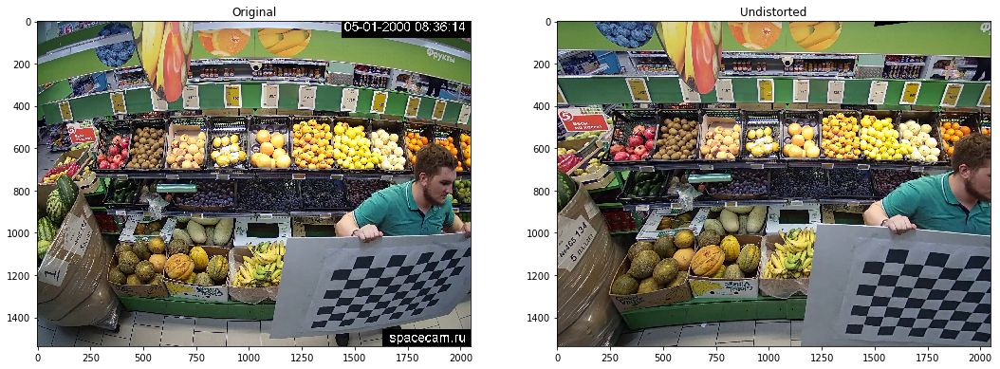

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_14.jpg


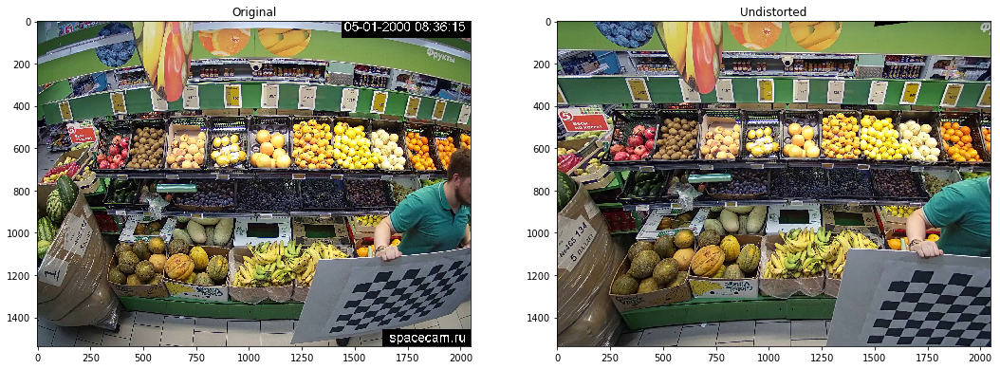

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_15.jpg


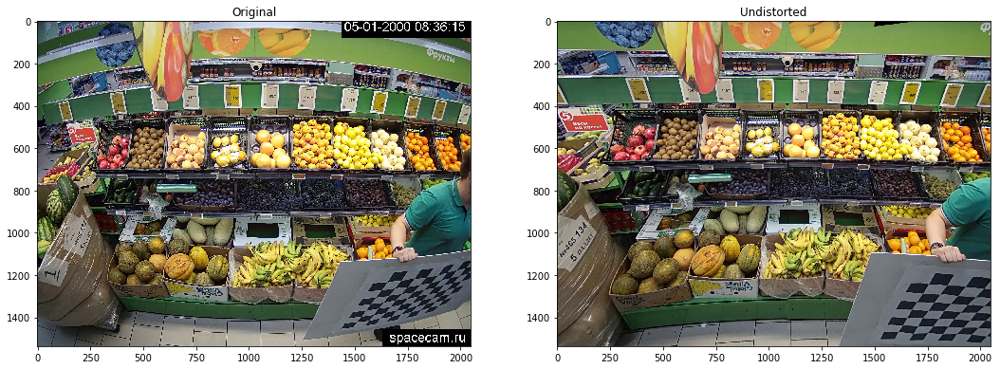

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_16.jpg


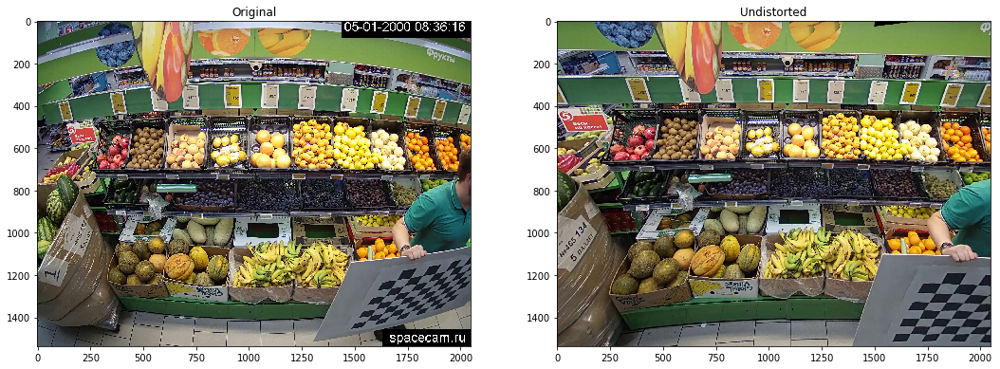

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_2.jpg


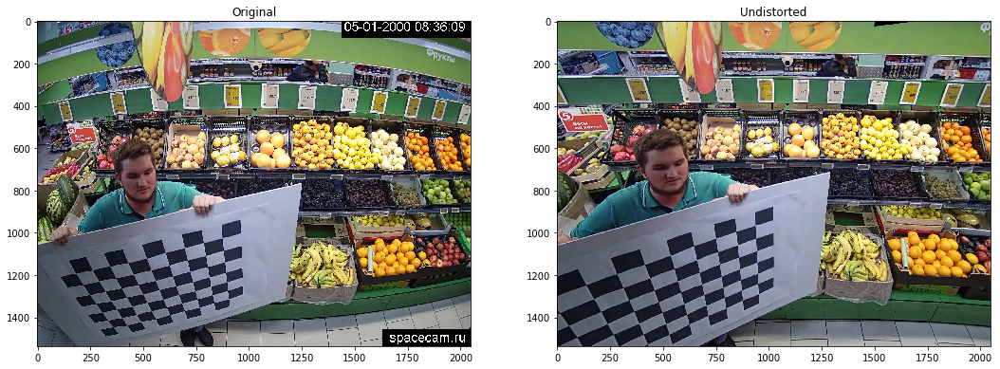

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_3.jpg


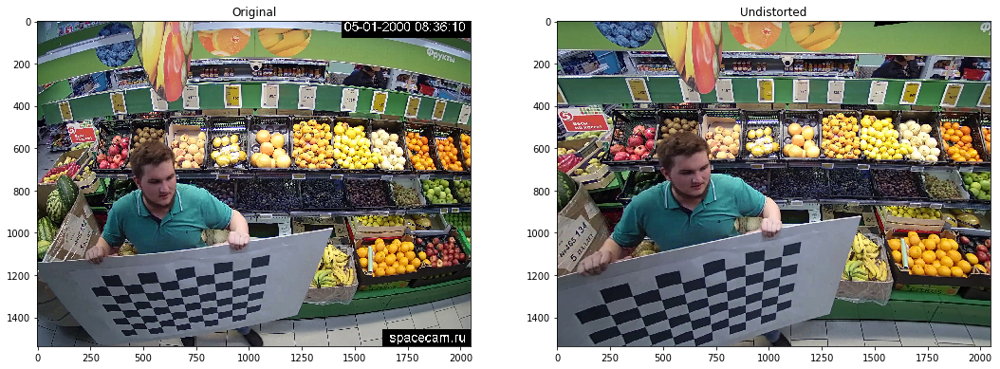

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_4.jpg


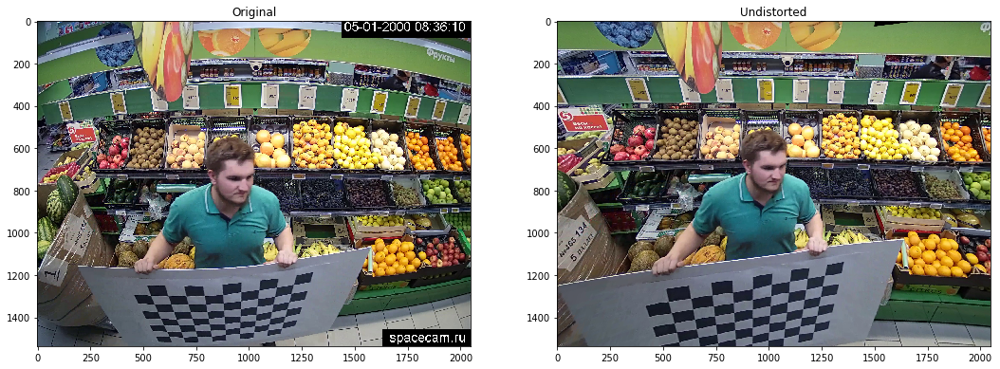

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_5.jpg


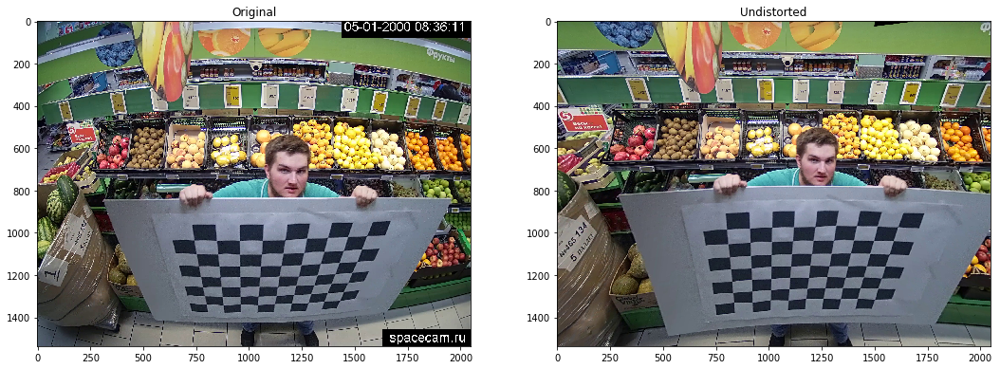

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_6.jpg


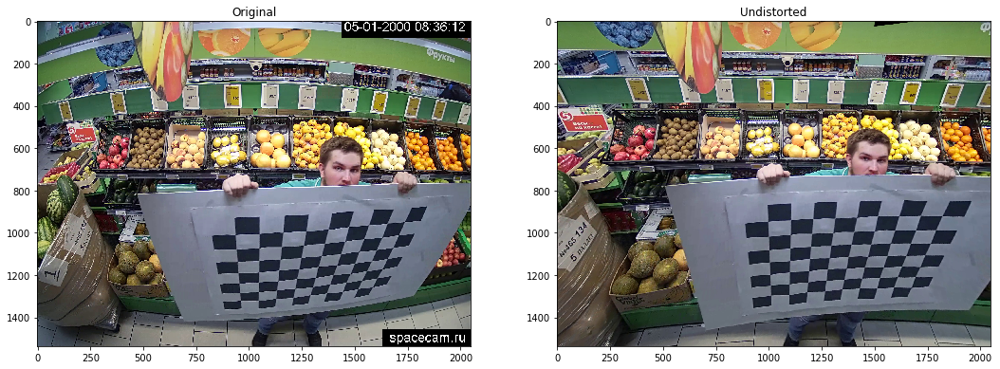

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_7.jpg


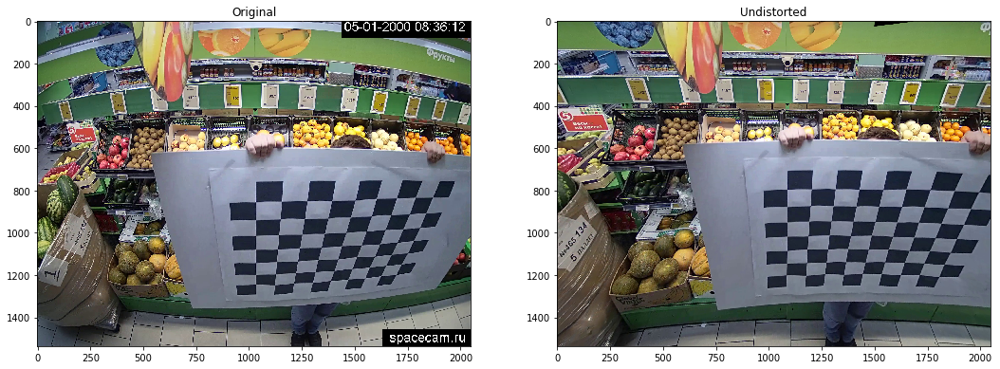

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_8.jpg


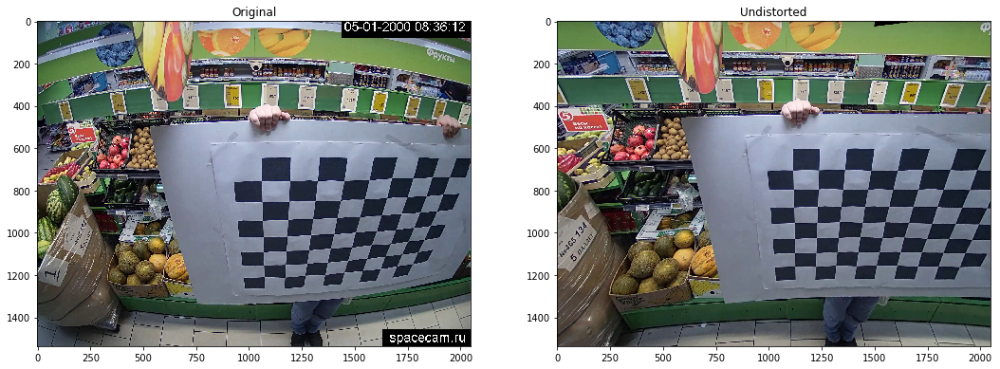

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.22\frame_9.jpg


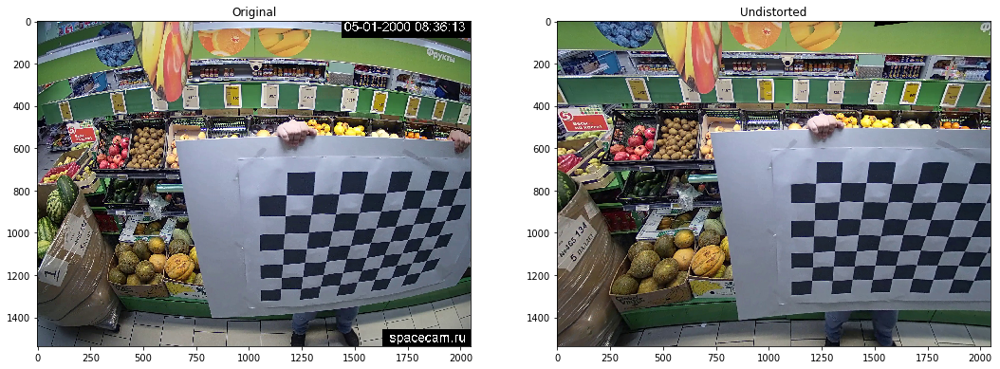

In [301]:
flag = True

for img in images:
    if os.path.exists(filename_matrix):
        print(flag)
        scaled_K, D = load_txt_files(filename_matrix, filename_distortion)
        print("Load successful")
        print("scaled_K \n",scaled_K)
        print("D \n", D)
                
        undistort(img, scaled_K=scaled_K, D=D)
    else:
        undistort(img, D=D)
    
    

In [302]:
total_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], K, D)
    error = cv2.norm(imgpoints[i],imgpoints2, cv2.NORM_L2)/len(imgpoints2)
    total_error += error
    
print("total error: ", total_error/len(objpoints))


total error:  2388.6760708566467


True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_0.jpg


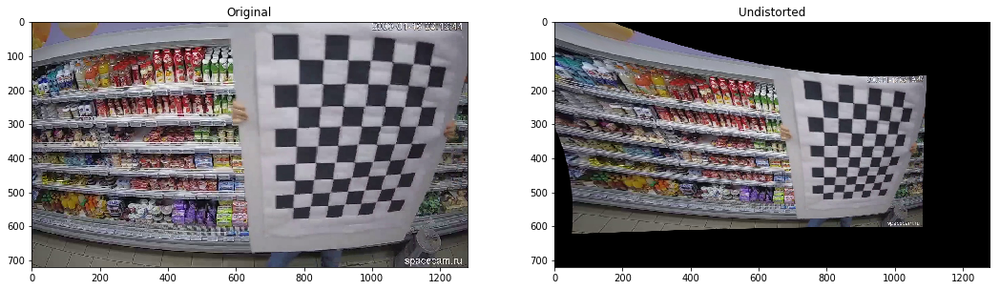

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_1.jpg


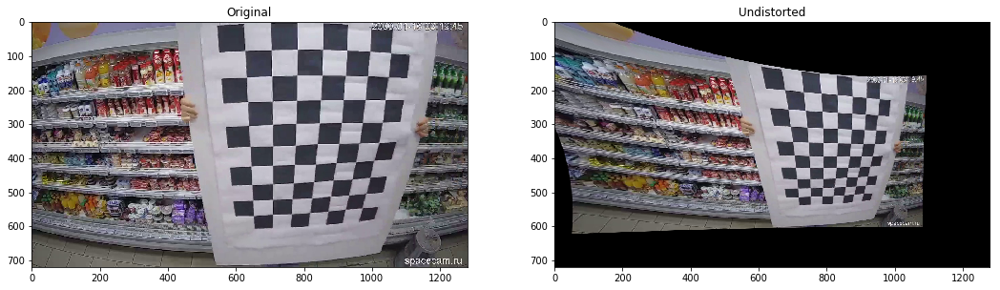

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_10.jpg


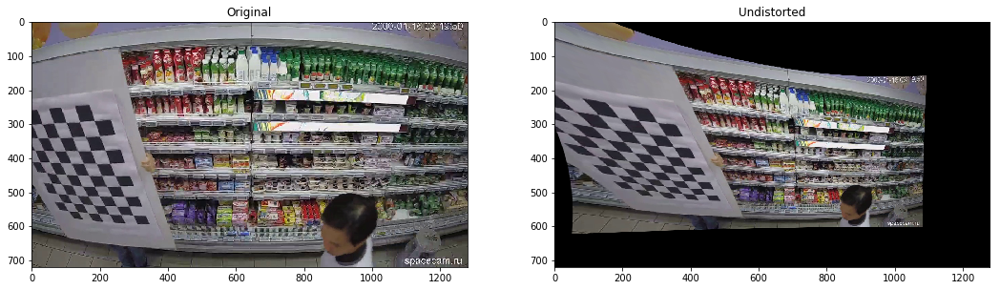

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_11.jpg


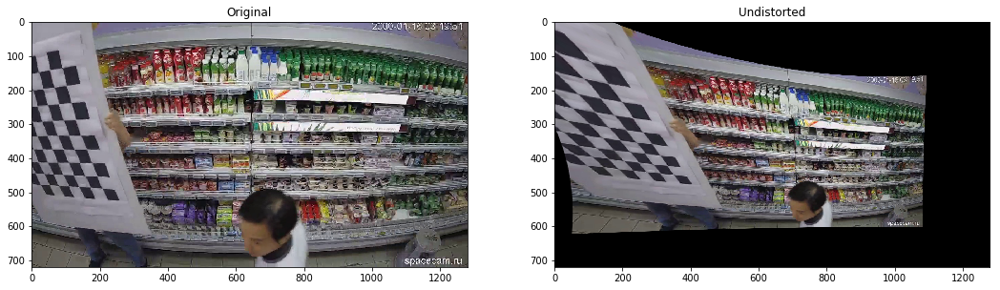

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_2.jpg


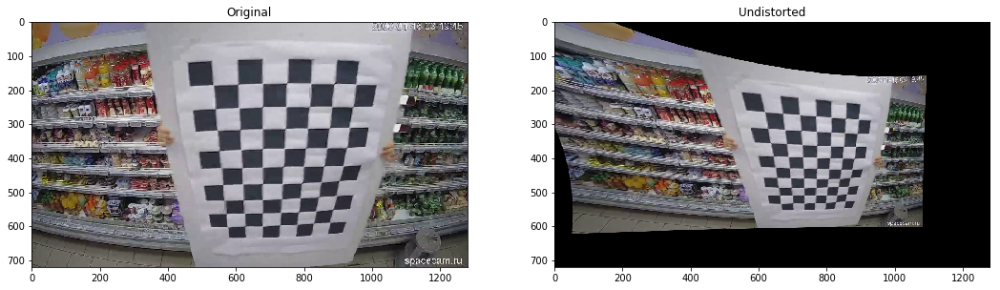

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_3.jpg


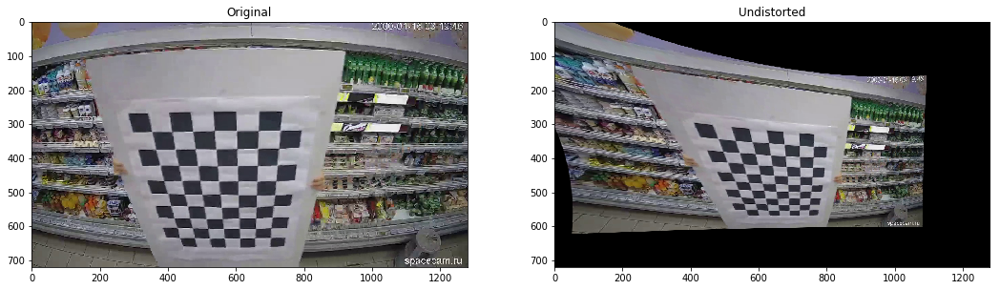

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_4.jpg


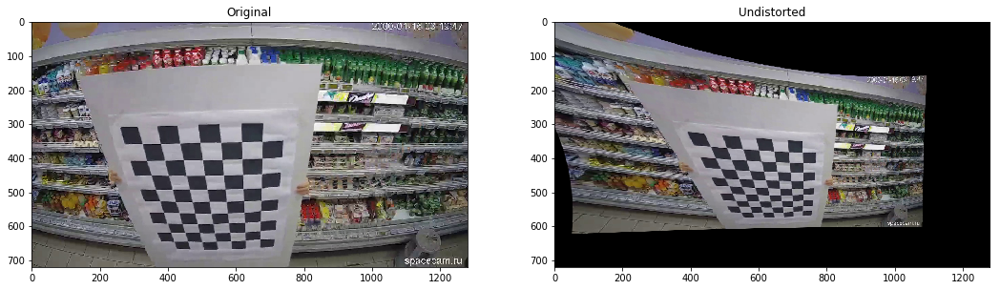

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_5.jpg


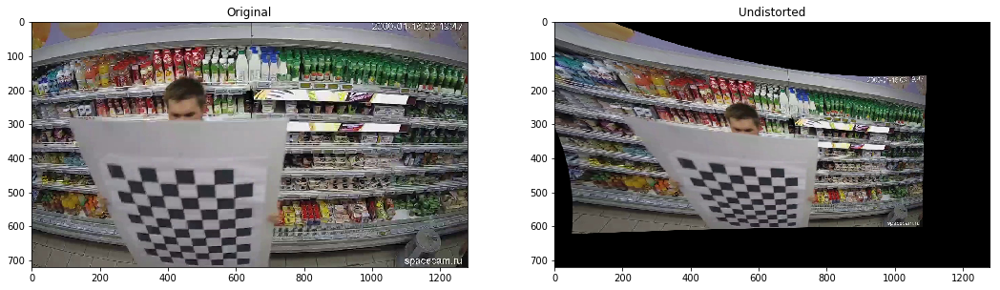

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_6.jpg


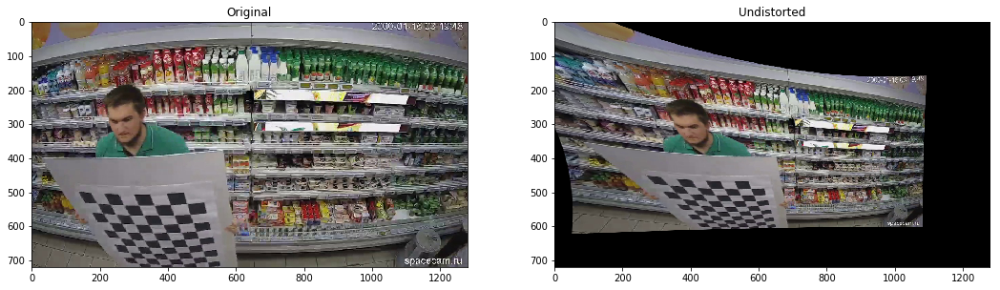

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_7.jpg


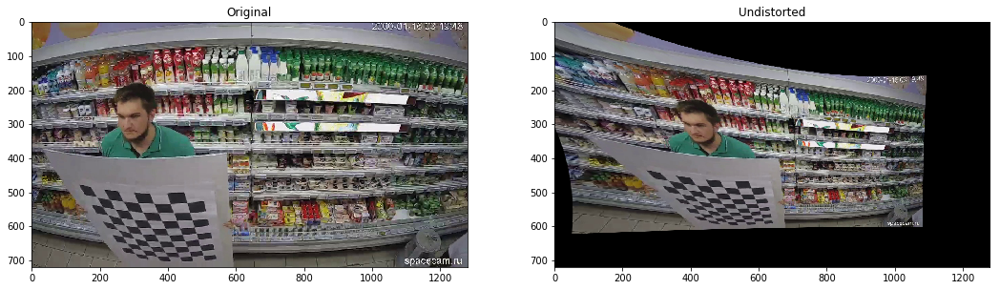

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_8.jpg


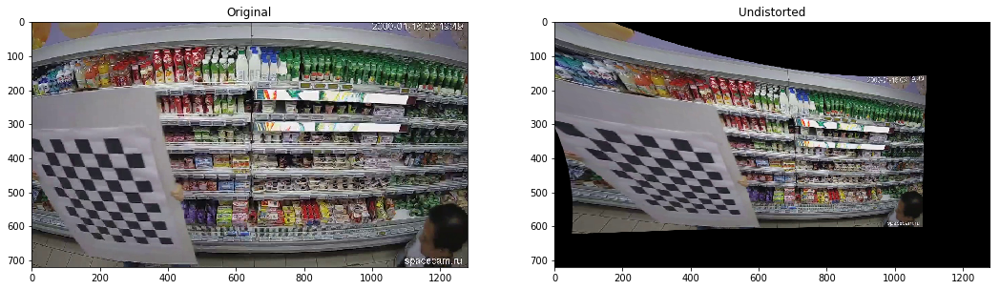

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.13\frame_9.jpg


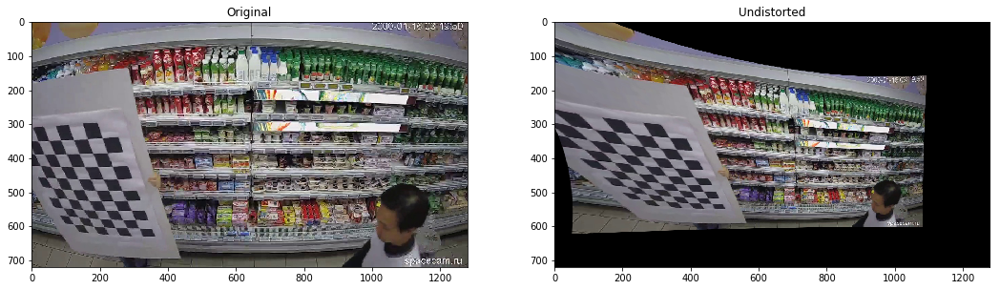

In [238]:
flag = True

for img in images:
    if os.path.exists(filename_matrix):
        print(flag)
        scaled_K, D = load_txt_files(filename_matrix, filename_distortion)
        print("Load successful")
        print("scaled_K \n",scaled_K)
        print("D \n", D)
                
        undistort(img, scaled_K=scaled_K, D=D, balance=1.0)
    else:
        undistort(img, D=D)
    
    

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_0.jpg


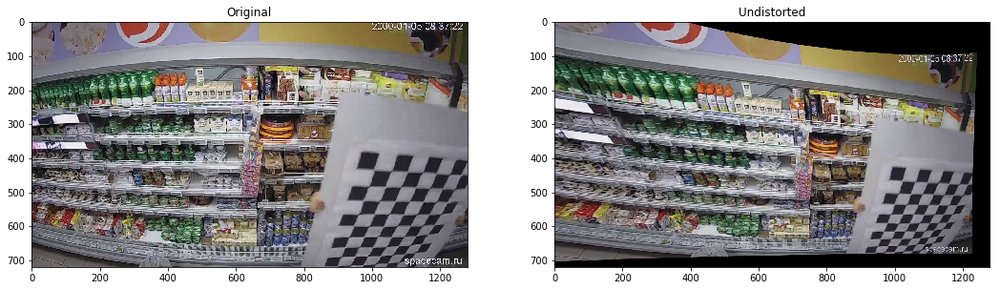

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_1.jpg


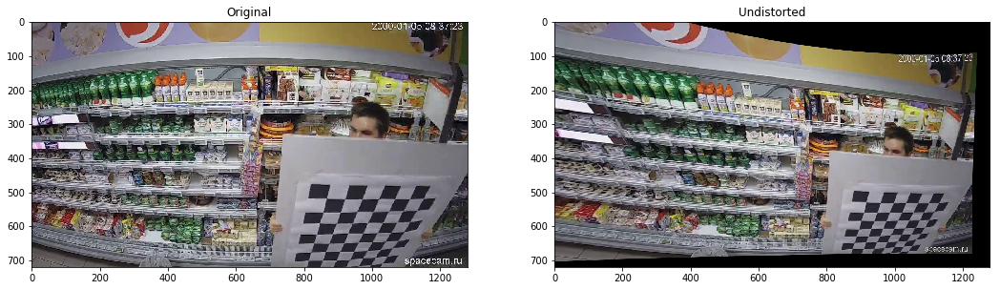

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_10.jpg


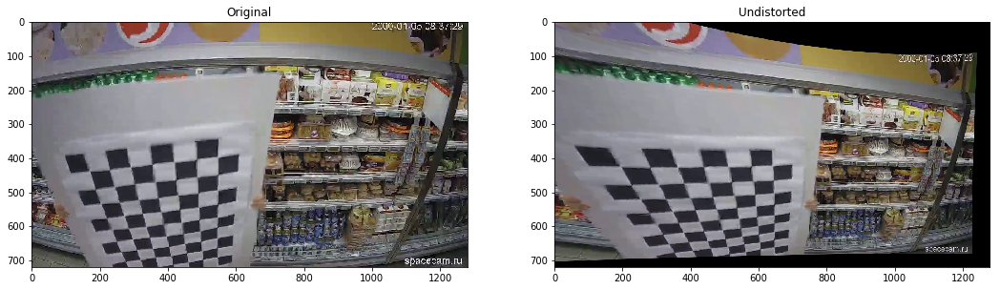

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_11.jpg


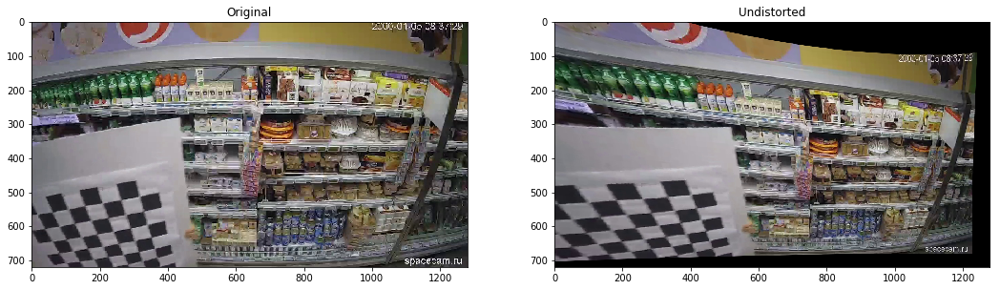

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_12.jpg


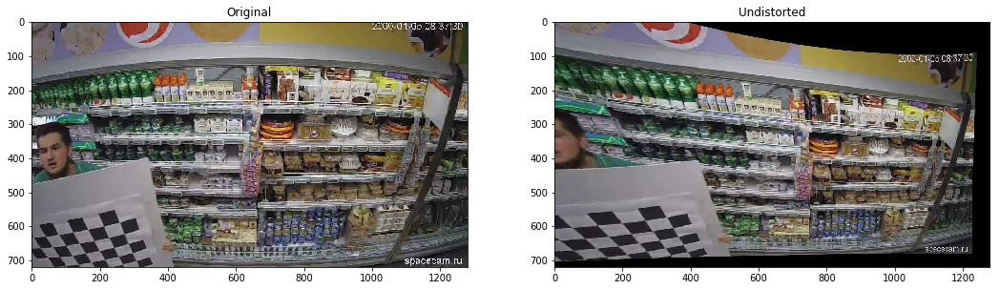

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_2.jpg


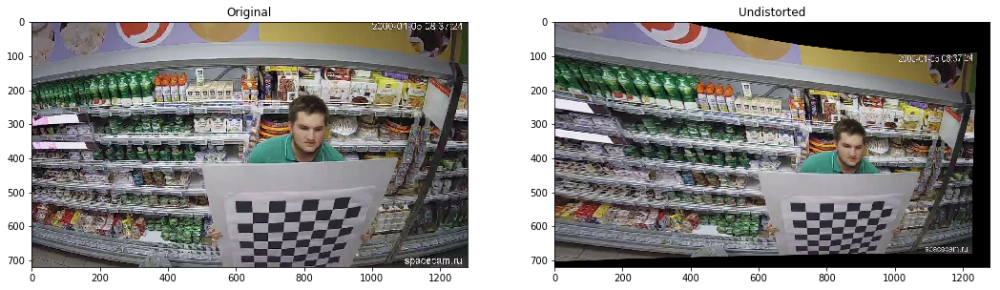

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_3.jpg


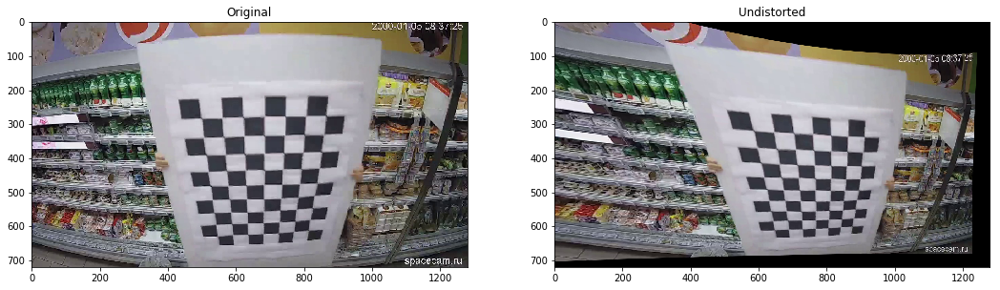

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_4.jpg


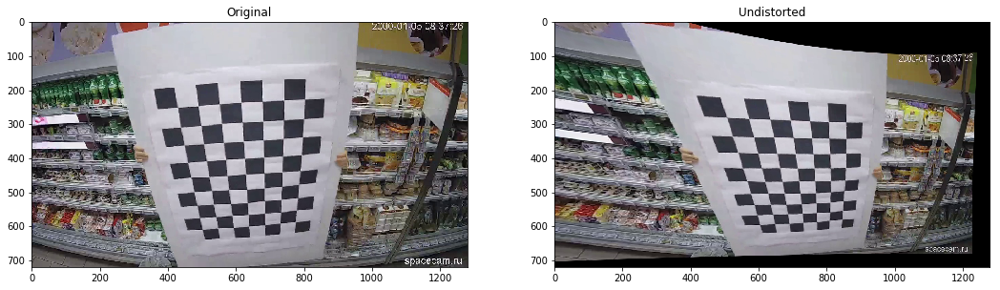

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_5.jpg


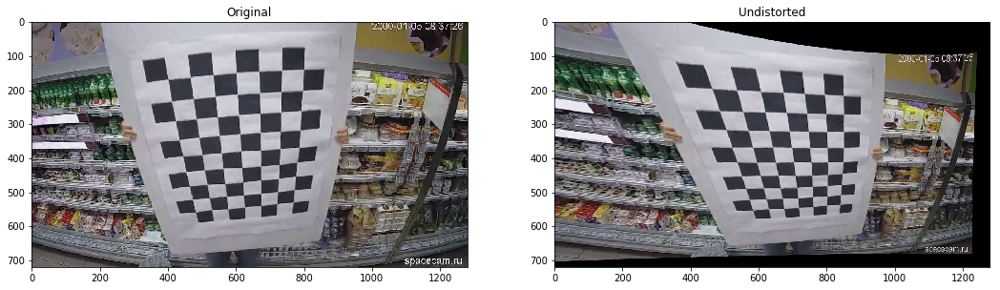

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_6.jpg


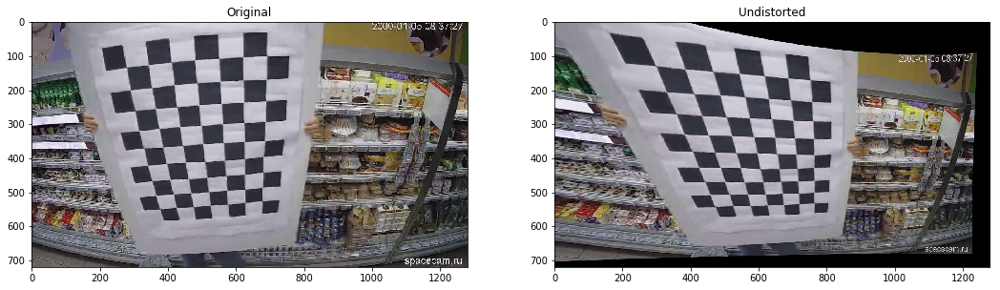

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_7.jpg


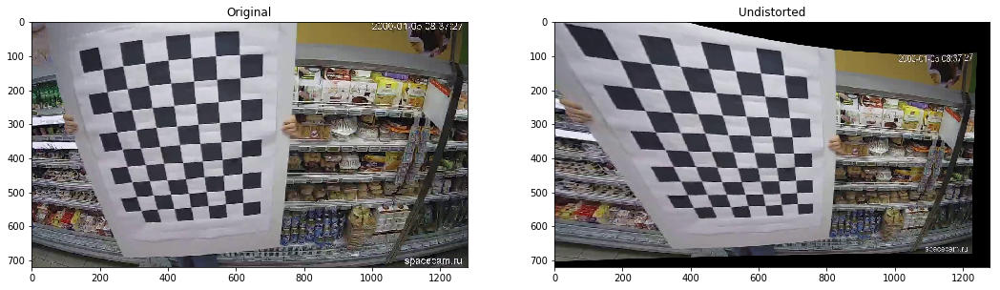

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_8.jpg


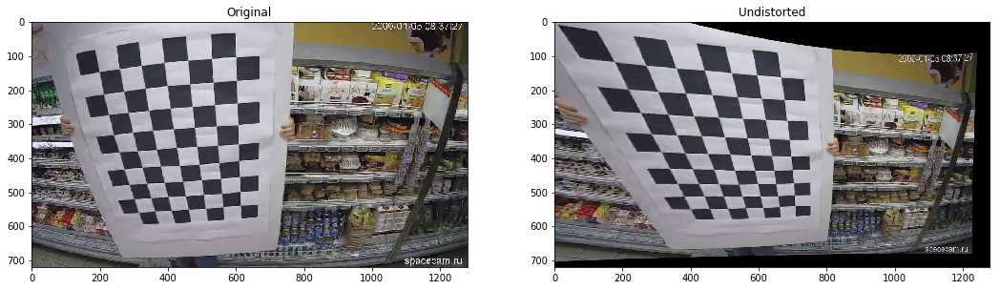

True
Load successful
scaled_K 
 [[1.15364308e+03 0.00000000e+00 1.09410169e+03]
 [0.00000000e+00 1.23015894e+03 6.45003811e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
D 
 [-0.0248835   0.02052632  0.10753789 -0.12803817]
./data/Video_with_chessboard/save_frames_10.222.255.12\frame_9.jpg


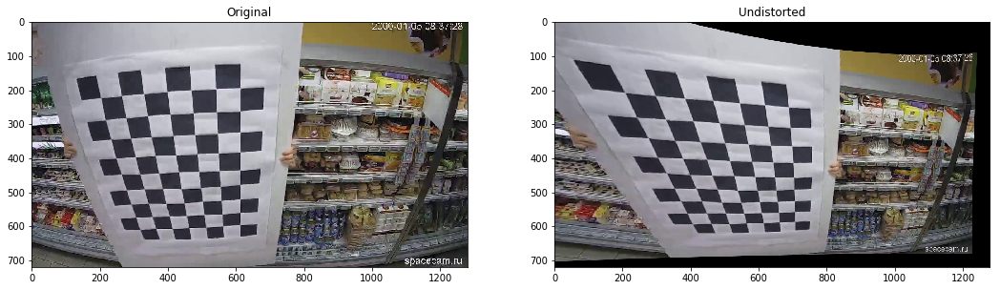

In [160]:
flag = True

for img in images:
    if os.path.exists(filename_matrix):
        print(flag)
        scaled_K, D = load_txt_files(filename_matrix, filename_distortion)
        print("Load successful")
        print("scaled_K \n",scaled_K)
        print("D \n", D)
                
        undistort(img, scaled_K=scaled_K, D=D, balance=0.6)
    else:
        undistort(img, D=D)
    
    